In [1]:
import matplotlib
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
from IPython.display import HTML
%matplotlib inline

In [2]:
colors = [(1, 0, 0), (0, 0, 0), (0, 1, 0)]
positions = [-1, 0, 1]
norm = plt.Normalize(min(positions), max(positions))
r_bl_g = LinearSegmentedColormap.from_list('r_bl_g', list(zip(norm(positions), colors)))

In [3]:
class ParticleInfo:
    def __init__(self, fam_idx, x, y, vx, vy):
        self.fam_idx = fam_idx
        self.x = x
        self.y = y
        self.vx = vx
        self.vy = vy

In [4]:
def initialize_force_matrix(m, assign_rand):
    if assign_rand:
        force_matrix = np.random.randint(-100, 101, size=(m, m)) / 100
    else:
        force_matrix = np.zeros((m, m))

    return force_matrix

In [31]:
def initialize_mutation_matrix(m, assign_rand):
    if assign_rand:
        # mutate_matrix = np.random.randint(0, 101, size=(m, m)) / 100
        mutate_matrix = np.random.rand(m, m)
        mutate_matrix /= mutate_matrix.sum(axis=1, keepdims=True)
    else:
        # mutate_matrix = np.zeros((m, m))
        mutate_matrix = np.eye(m)

    return mutate_matrix

In [6]:
def update_force_matrix(force_matrix, row, col, value):
    if 0 <= row < m and 0 <= col < m:
        force_matrix[row, col] = value * 100
    else:
        raise ValueError("Invalid row or column index for force_matrix update.")

    return force_matrix

In [7]:
def update_particles(particles, x, y):
    for a in particles:

        a.x = (a.x + a.vx * dt + x) % x;
        a.y = (a.y + a.vy * dt + y) % y;

        a.vx *= friction
        a.vy *= friction

In [8]:
def mutate_particles(particles, mutation_matrix):
    m = mutation_matrix.shape[0]
    new_particles = []

    for a in particles:
        current_color = a.fam_idx
        probabilities = mutation_matrix[current_color]

        new_color = np.random.choice(m, p=probabilities)

        a.fam_idx = new_color

In [9]:
def rule(particles, force_matrix, size_x, size_y):
    for i in range(n):
        fx = 0
        fy = 0
        a = particles[i]

        for j in range(n):
            b = particles[j]

            if b != a:
                dx = a.x - b.x
                dy = a.y - b.y

                if (abs(dx) > size_x / 2):
                  dx -= np.sign(dx) * size_x;

                if (abs(dy) > size_y / 2):
                  dy -= np.sign(dy) * size_y;

                attraction = force_matrix[a.fam_idx, b.fam_idx] * 100

                d = np.sqrt(dx**2 + dy**2)
                current_force = 0

                if min_distance <= d <= max_distance:
                    t = (d - min_distance) / (max_distance - min_distance)
                    current_force = (1 - abs(t - 0.5) * 2) * attraction
                elif d > max_distance:
                    current_force = 0
                elif d < min_distance:
                    t = min_distance / d
                    current_force = t * universal_repulsive_force

                if d == 0:
                    raise ValueError("Distance is equal to Zero!")

                fx += dx / d * current_force
                fy += dy / d * current_force

        fx *= max_distance
        fy *= max_distance

        a.vx += fx * dt
        a.vy += fy * dt

In [10]:
def generate_particles(n, x, y, m):
    particle_list = []

    for i in range(n):
        x_pos = np.random.uniform(-x, x)
        y_pos = np.random.uniform(-y, y)
        idx = np.random.randint(0, m)

        particle = ParticleInfo(idx, x_pos, y_pos, 0, 0)
        particle_list.append(particle)

    return particle_list

In [41]:
# Parameters
x = 800
y = 800
n = 500
m = 3

# Global Values
dt = 0.009
friction = 0.01
universal_repulsive_force = 100
max_distance = 100
min_distance = 15

In [42]:
particles = generate_particles(n, x, y, m)

force_matrix = initialize_force_matrix(m, True)
# force_matrix = np.array([[-1, 1],
#                          [1, -1]])

mutation_matrix = initialize_mutation_matrix(m, False)

# mutation_matrix = np.array([[0.99, 0.01],
#                             [0.0, 1.00]])

print("Force Matrix: ")
print(force_matrix)

print("\nMutant Matrix: ")
print(mutation_matrix)

Force Matrix: 
[[-0.26 -0.97  0.57]
 [-0.63  0.21  0.43]
 [-0.94 -0.46  0.8 ]]

Mutant Matrix: 
[[1. 0. 0.]
 [0. 1. 0.]
 [0. 0. 1.]]


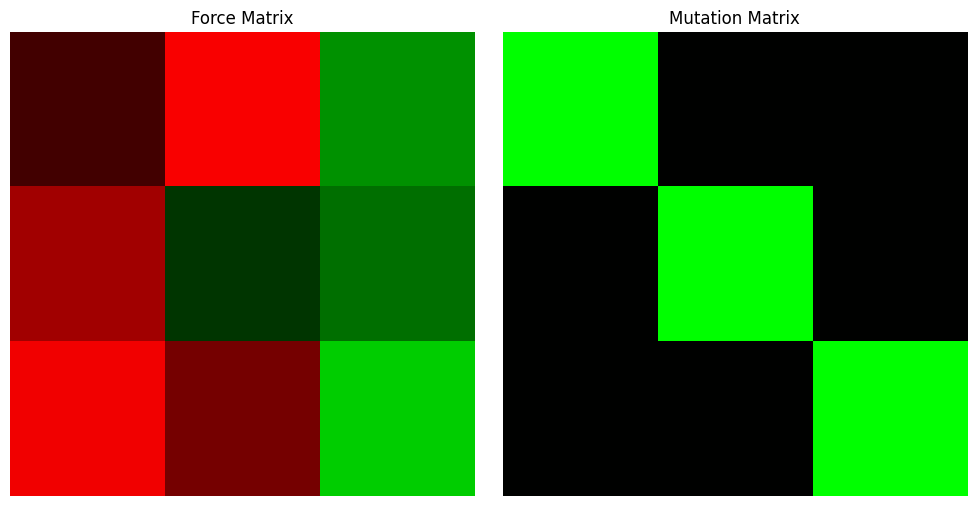

In [44]:
normalize = matplotlib.colors.Normalize(vmin=-1, vmax=1)
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

# Display the force_matrix in the first subplot
axs[0].imshow(force_matrix, cmap=r_bl_g, norm=normalize)
axs[0].axis('off')  # Turn off axes
axs[0].set_title('Force Matrix')

# Display the mutation_matrix in the second subplot
axs[1].imshow(mutation_matrix, cmap=r_bl_g, norm=normalize)
axs[1].axis('off')  # Turn off axes
axs[1].set_title('Mutation Matrix')

# Adjust layout to prevent clipping of titles
plt.tight_layout()

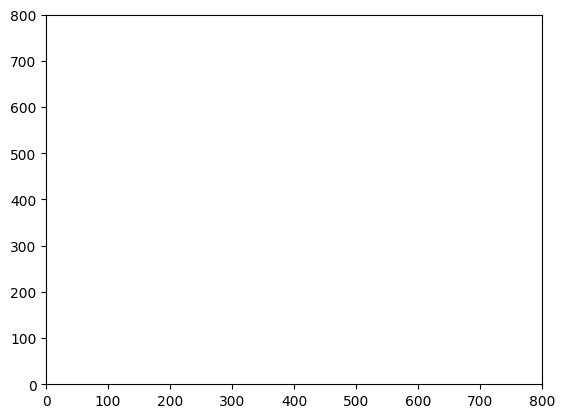

In [45]:
figure = plt.figure()
axes = plt.axes(xlim=(0, x), ylim=(0, y))

In [46]:
def animate(frame):
    rule(particles, force_matrix, x, y)
    mutate_particles(particles, mutation_matrix)
    update_particles(particles, x, y)

    x_values, y_values = zip(*[(p.x, p.y) for p in particles])
    colors = plt.cm.hsv(np.array([a.fam_idx for a in particles]) / m)

    axes.cla()

    axes.scatter(x_values, y_values, c=colors)

    axes.set(xlim=(0, x), ylim=(0, y))

    # axes.set_title("Frame: " + str(i+1))
    # plt.show()

In [47]:
anim = animation.FuncAnimation(figure, animate, frames=100, interval=50)

In [48]:
HTML(anim.to_jshtml())

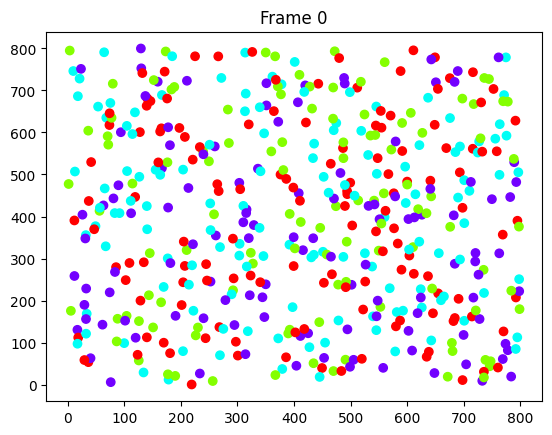

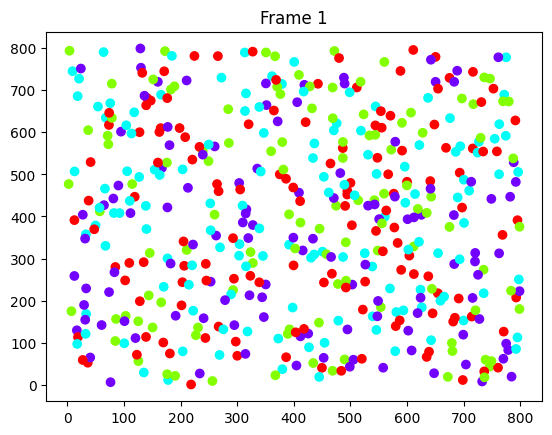

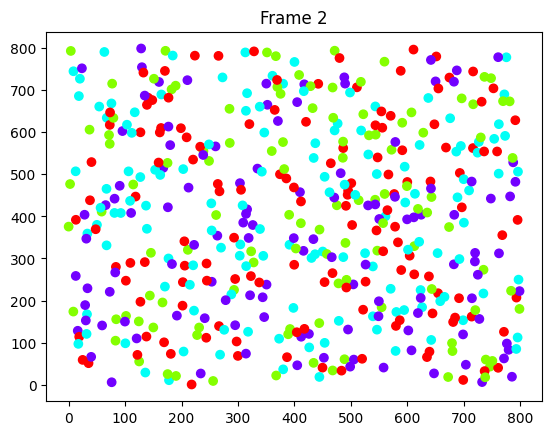

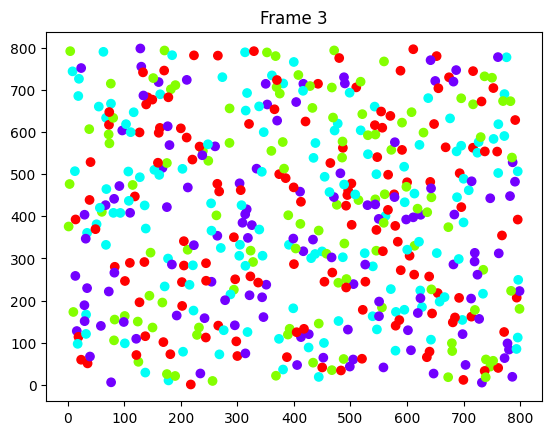

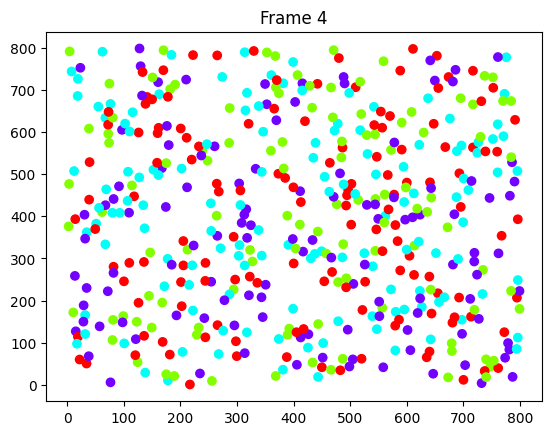

...

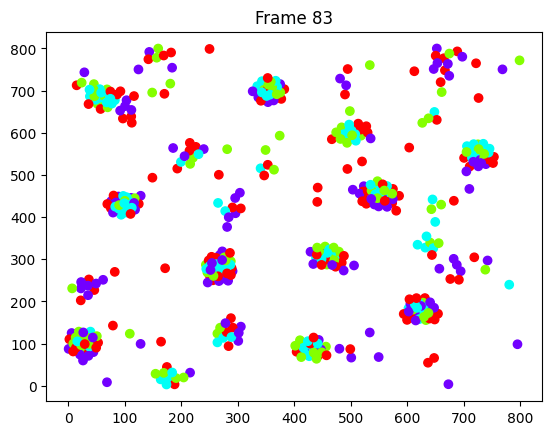

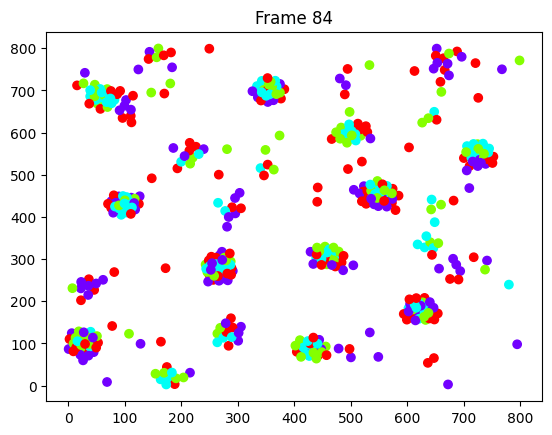

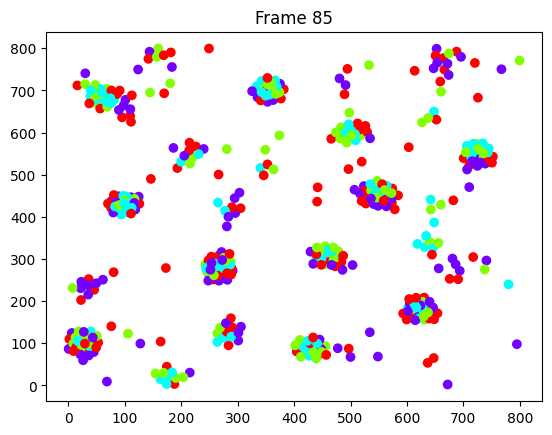

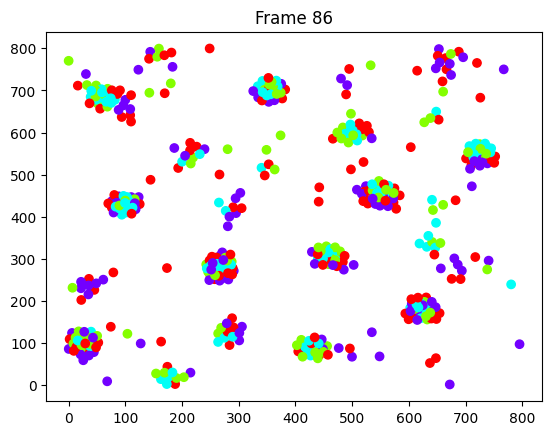

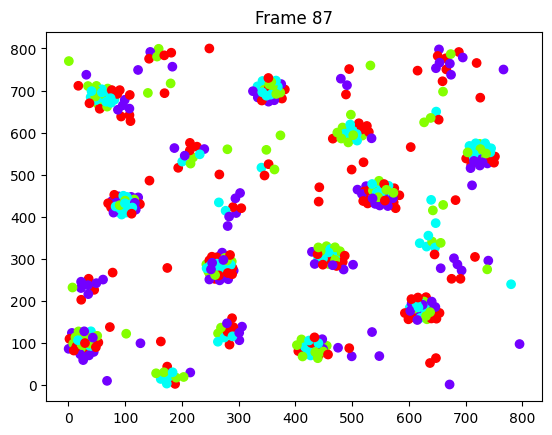

KeyboardInterrupt: 

In [38]:
for i in range(250):
  rule(particles, force_matrix, x, y)
  mutate_particles(particles, mutation_matrix)
  update_particles(particles, x, y)

  x_values, y_values = zip(*[(p.x, p.y) for p in particles])
  colors = plt.cm.hsv(np.array([a.fam_idx for a in particles]) / m)

  plt.cla()
  plt.scatter(x_values, y_values, c=colors)

  plt.title("Frame " + str(i))

  axes.set(xlim=(0, x), ylim=(0, y))
  axes.set_aspect('equal')
  axes.get_xaxis().set_visible(False)
  axes.get_yaxis().set_visible(False)
  plt.pause(0.001)